#      Predicting US Border Crossings

This dataset contains all the incidents of crossing the border into the US as provided by the Bureau of Transportation Statistics, Govt. of the US. This dataset tells us about the incoming counts into the US.

This dataset can prove to be a vital in predicting the average incoming counts into the future seeing the current trend. An initial look tells us that 77% of the incidents marked in the dataset consisted of US-Canada border meaning Canadians have tended to come in more frequently into the US as compared to the Mexicans.

This data can also prove to useful to predict the daily or weekly or monthly or annual traffic that's going to accumulate on the borders so that the authorities can be aware of the number beforehand.

**Links:**

https://www.kaggle.com/divyansh22/us-border-crossing-data


In [1]:
#Load the necessary packages:
import pandas as pd
import numpy as np

import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px
import plotly.graph_objects as go

import json
%matplotlib inline

import matplotlib.dates as mdates
import calendar 
from datetime import timedelta

/Users/joseph_arber/opt/anaconda3/lib/python3.7/site-packages/statsmodels/tools/_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


In [2]:
border_df = pd.read_csv('data/Border_Crossing_Entry_Data.csv')
border_df.head()

,Port Name,State,Port Code,Border,Date,Measure,Value
0,Alcan,AK,3104,US-Canada Border,2/1/2020 00:00,Personal Vehicle Passengers,1414
1,Alcan,AK,3104,US-Canada Border,2/1/2020 00:00,Personal Vehicles,763
2,Alcan,AK,3104,US-Canada Border,2/1/2020 00:00,Truck Containers Empty,412
3,Alcan,AK,3104,US-Canada Border,2/1/2020 00:00,Truck Containers Full,122
4,Alcan,AK,3104,US-Canada Border,2/1/2020 00:00,Trucks,545


#       Exploratory Data Analysis of the US Border-Crossing Dataset

###        EDA 1

In [15]:
#Pandas profiling tool:
from pandas_profiling import ProfileReport 
report = ProfileReport(border_df)
report

In [3]:
border_df.shape #There are 355000 observations and 7 columns

(355511, 7)

In [4]:
# Count the how many people have crossed the borders
border_df['Value'].value_counts()

0         122392
1           3333
2           2304
3           1741
4           1496
           ...  
29300          1
17010          1
320076         1
21104          1
17783          1
Name: Value, Length: 54814, dtype: int64

In [5]:
print(border_df.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 355511 entries, 0 to 355510
Data columns (total 7 columns):
 #   Column     Non-Null Count   Dtype 
---  ------     --------------   ----- 
 0   Port Name  355511 non-null  object
 1   State      355511 non-null  object
 2   Port Code  355511 non-null  int64 
 3   Border     355511 non-null  object
 4   Date       355511 non-null  object
 5   Measure    355511 non-null  object
 6   Value      355511 non-null  int64 
dtypes: int64(2), object(5)
memory usage: 19.0+ MB
None


In [6]:
border_df.isnull().any()

Port Name    False
State        False
Port Code    False
Border       False
Date         False
Measure      False
Value        False
dtype: bool

In [7]:
#pd.crosstab(index = border_df['Port Name'], columns = border_df['model_year'])

In [8]:
# Check the summary statistics
border_df.describe()

,Port Code,Value
count,355511.000000,3.555110e+05
mean,2454.009921,2.844758e+04
std,1201.900231,1.518807e+05
min,101.000000,0.000000e+00
25%,2304.000000,0.000000e+00
50%,3013.000000,1.000000e+02
75%,3402.000000,2.597500e+03
max,4105.000000,4.447374e+06


In [9]:
# Convert dates from strings to date format
border_df['Date'] = pd.to_datetime(border_df['Date'])

In [10]:
# Check the data types
border_df.dtypes

Port Name            object
State                object
Port Code             int64
Border               object
Date         datetime64[ns]
Measure              object
Value                 int64
dtype: object

### EDA - Borders

In [11]:
# Check if borders are unique
borders = border_df['Border'].unique()
print(borders)

['US-Canada Border' 'US-Mexico Border']


In [12]:
# Check which years the the date column extends to
years = border_df['Date'].map(lambda x : x.year).unique()
years

array([2020, 2019, 2018, 2017, 2016, 2015, 2014, 2013, 2012, 2011, 2010,
       2009, 2008, 2007, 2006, 2005, 2004, 2003, 2002, 2001, 2000, 1999,
       1998, 1997, 1996])

In [13]:
# Check if the means of arrival column is unique
border_df['Measure'].unique()

array(['Personal Vehicle Passengers', 'Personal Vehicles',
       'Truck Containers Empty', 'Truck Containers Full', 'Trucks',
       'Bus Passengers', 'Buses', 'Pedestrians', 'Rail Containers Empty',
       'Rail Containers Full', 'Train Passengers', 'Trains'], dtype=object)

In [14]:
people = border_df[border_df['Measure'].isin(['Personal Vehicle Passengers', 'Bus Passengers','Pedestrians', 'Train Passengers'])]
vehicles = border_df[border_df['Measure'].isin(['Trucks', 'Rail Containers Full','Truck Containers Empty', 'Rail Containers Empty',
       'Personal Vehicles', 'Buses', 'Truck Containers Full'])]

In [15]:
people_borders = people[['Border','Value']].groupby('Border').sum()
people_borders

,Value
Border,
US-Canada Border,1682036237
US-Mexico Border,5190058574


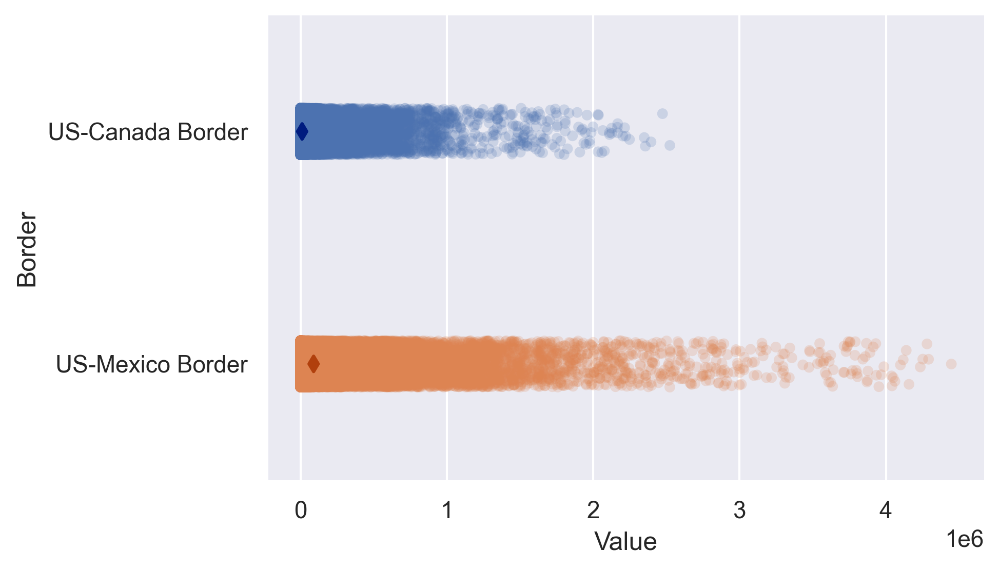

In [16]:
sns.set(style="darkgrid")

# Initialize the figure
fg, ax = plt.subplots(dpi = 300)
sns.despine(bottom=True, left=True)

# Show each observation with a scatterplot
sns.stripplot(x="Value", y="Border",
              data=border_df, dodge=True, alpha=0.2, zorder=1)

# Show the conditional means
sns.pointplot(x="Value", y="Border",
              data=border_df, dodge=.532, join=False, palette="dark",
              markers="d", scale=.75, ci=None)

In [17]:
values = people_borders.values.flatten()
labels = people_borders.index
fig = go.Figure(data=[go.Pie(labels = labels, values=values)])
fig.update(layout_title_text='Total inbound persons, since 1996')
fig.show()

In [18]:
# Take the values and set the date as index
p = border_df[['Date','Border','Value']].set_index('Date')

In [19]:
# Group by years and border
p = p.groupby([p.index.year, 'Border']).sum()
p.head(10)

Value
Date Border                     
1996 US-Canada Border  153038903
     US-Mexico Border  276751448
1997 US-Canada Border  145512710
     US-Mexico Border  348661488
1998 US-Canada Border  142291790
     US-Mexico Border  366296614
1999 US-Canada Border  146497328
     US-Mexico Border  391959396
2000 US-Canada Border  147789673
     US-Mexico Border  392231869

In [20]:
import seaborn as sns

In [21]:


val_MEX = p.loc(axis=0)[:,'US-Mexico Border'].values.flatten().tolist()
val_CAN = p.loc(axis=0)[:,'US-Canada Border'].values.flatten().tolist()
yrs = p.unstack(level=1).index.values

# Bar chart 
fig = go.Figure(go.Bar(x = yrs, y = val_MEX, name='US-Mexico Border', marker_color='rgb(55, 83, 109)'))
fig.add_trace(go.Bar(x = yrs, y = val_CAN, name='US-Canada Border', marker_color='rgb(69,117, 180)'))

fig.update_layout(title = 'Total inbound people, by border and years', barmode='stack', xaxis={'categoryorder':'category ascending'})
fig.show()

### EDA - States and Port Entry Points

From the code below we can see that the state of North Dakota (ND) has had the most amount of people crossing the border with 58300, while the state of Ohio (OH) has had the least with 10 only.

In [22]:
#What states are people entering the US in?
border_df['State'].value_counts()

ND    58290
WA    45836
ME    39108
MT    38930
TX    36758
MN    23693
NY    21323
AZ    19747
CA    19553
VT    16727
AK    11787
MI    10372
ID     6762
NM     6615
OH       10
Name: State, dtype: int64

The same exploration can be done on the "Port" column. We can see that **Eastport** has seen the largest passing of people.

In [23]:
border_df['Port Name'].value_counts()

Eastport                  5753
Calais                    3480
Portal                    3480
Champlain-Rouses Point    3480
Nogales                   3480
                          ... 
Bar Harbor                1068
Boquillas                  261
Algonac                     33
Cross Border Xpress         29
Toledo-Sandusky             10
Name: Port Name, Length: 116, dtype: int64

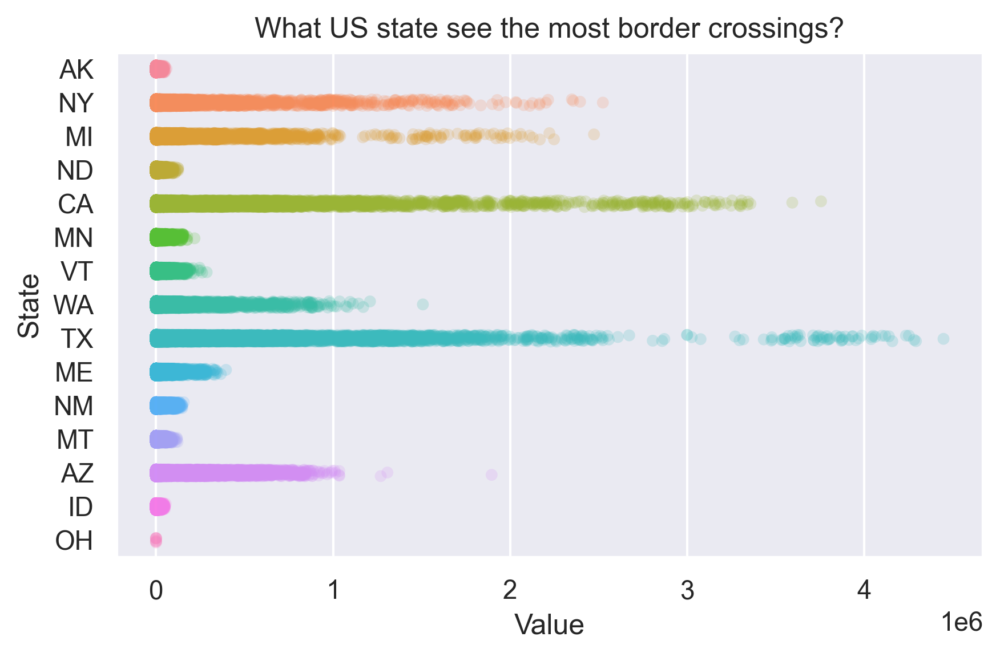

In [24]:
fg, ax = plt.subplots(dpi=300)
sns.stripplot(y='State', x='Value', alpha =0.2, data = border_df);
ax.set_title('What US state see the most border crossings?')
fg.tight_layout()

In [25]:
border_df.head()

,Port Name,State,Port Code,Border,Date,Measure,Value
0,Alcan,AK,3104,US-Canada Border,2020-02-01,Personal Vehicle Passengers,1414
1,Alcan,AK,3104,US-Canada Border,2020-02-01,Personal Vehicles,763
2,Alcan,AK,3104,US-Canada Border,2020-02-01,Truck Containers Empty,412
3,Alcan,AK,3104,US-Canada Border,2020-02-01,Truck Containers Full,122
4,Alcan,AK,3104,US-Canada Border,2020-02-01,Trucks,545


In [26]:
avg_state = border_df.groupby(border_df['State'])['Value'].mean()

In [27]:
avg_state

State
AK      1245.173157
AZ     46502.652504
CA    133103.511993
ID      3228.836143
ME      6054.553135
MI     74759.961531
MN      4183.808931
MT      1442.061033
ND      1348.446800
NM     10364.373696
NY     40052.647329
OH        60.700000
TX    101960.920861
VT      7061.449632
WA     11375.292587
Name: Value, dtype: float64

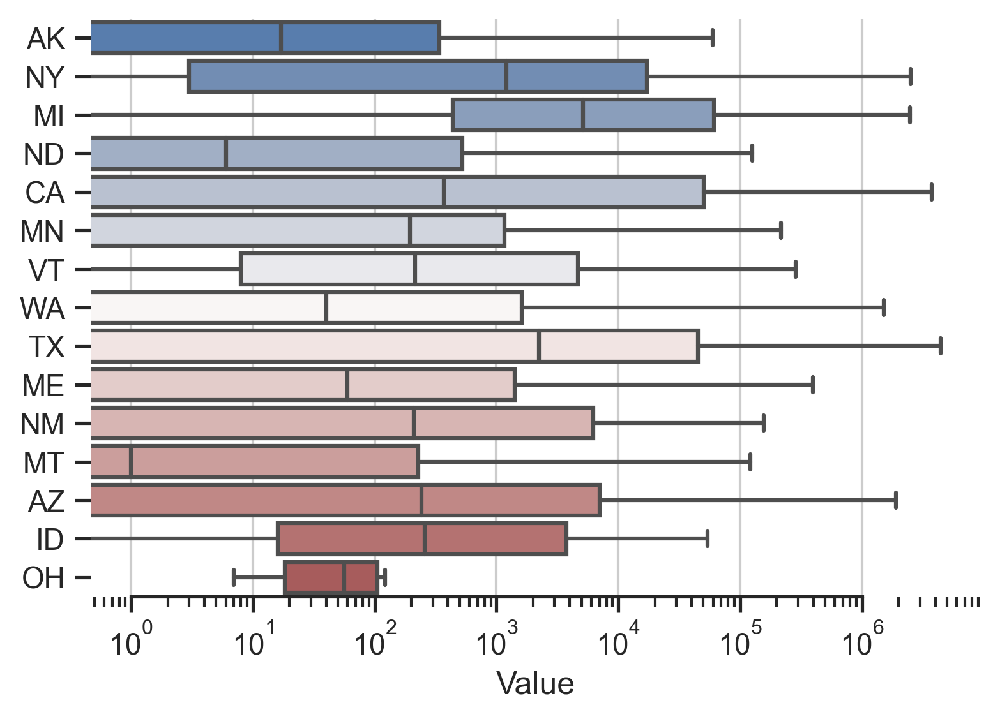

In [33]:
import seaborn as sns
import matplotlib.pyplot as plt

fg, ax = plt.subplots(dpi = 300)

sns.set(style="ticks")

# Initialize the figure with a logarithmic x axis

ax.set_xscale("log")

# Plot the orbital period with horizontal boxes
sns.boxplot(x="Value", y="State", data=border_df,
            whis=[0, 100], palette="vlag")

# Add in points to show each observation
#sns.swarmplot(x="Value", y="State", data=border_df,
            #  size=2, color=".3", linewidth=0)

# Tweak the visual presentation
ax.xaxis.grid(True)
ax.set(ylabel="")
sns.despine(trim=True, left=True)

#### Geospatial Analysis EDA

In [34]:
import plotly.graph_objects as go
import seaborn as sns

In [35]:
col = ['Port Name', 'Port Code', 'Border', 'Measure']
map1 = border_df.drop(col, axis=1)
map1.head()

,State,Date,Value
0,AK,2020-02-01,1414
1,AK,2020-02-01,763
2,AK,2020-02-01,412
3,AK,2020-02-01,122
4,AK,2020-02-01,545


In [ ]:
#Lets create a new dataframe called map1
map1=map1.groupby(["Date","State"])[["Value"]].sum().reset_index()

In [ ]:
#US Border Crossing Data by State: Average Data 1996-2020
fig = px.choropleth(map1, locations=map1["State"],       

 color=map1["Value"],
                    locationmode="USA-states",
                    scope="usa",
                    color_continuous_scale='Greens',
                    hover_data = [map1.count],
                    title="US Border Crossings by State: 1996-2020"
                   )

fig.show()

From the geospatial analysis above we can see that **Texas**, with a value of **14.3m** since 1996 has seen the most border crossings out of all the US states. 

In [ ]:
#US Border Crossing Geospatial Data: Month level
cdf=map1
cdf["Date"] = cdf["Date"].astype(str)
fig = px.choropleth(cdf, locations=cdf["State"],       

color=cdf["Value"],locationmode="USA-states", scope="usa",
                    animation_frame=cdf["Date"], color_continuous_scale='Greens', hover_data = [cdf.count],
                    title="US Border Crossings by State: Monthly Data"
                   )

fig.show()

### EDA - Mode of Entry into the US
Let's take a look at the 'Measure Column'. It will give an indication as to how individuals into the US arrived.

In [36]:
#We need to clean this data, as there are some descriptions that do not help us. Let's merge the relevant values:
df_1 = border_df.replace({"Train Passengers":"Train",
                     "Rail Containers Full":"Train",
                     "Rail Containers Empty":"Train",
                     "Trains":"Train",
                     "Bus Passengers":"Bus",
                     "Buses":"Bus",
                     "Trucks":"Truck",
                     "Truck Containers Full":"Truck",
                     "Truck Containers Empty":"Truck",
                     "Personal Vehicles":"Personal_vehicle",
                     "Personal Vehicle Passengers":"Personal_vehicle"})

In [37]:
df_1

,Port Name,State,Port Code,Border,Date,Measure,Value
0,Alcan,AK,3104,US-Canada Border,2020-02-01,Personal_vehicle,1414
1,Alcan,AK,3104,US-Canada Border,2020-02-01,Personal_vehicle,763
2,Alcan,AK,3104,US-Canada Border,2020-02-01,Truck,412
3,Alcan,AK,3104,US-Canada Border,2020-02-01,Truck,122
4,Alcan,AK,3104,US-Canada Border,2020-02-01,Truck,545
...,...,...,...,...,...,...,...
355506,Antler,ND,3413,US-Canada Border,1996-01-01,Personal_vehicle,1576
355507,Tecate,CA,2505,US-Mexico Border,1996-01-01,Truck,3228
355508,Calais,ME,115,US-Canada Border,1996-01-01,Truck,8955
355509,Carbury,ND,3421,US-Canada Border,1996-01-01,Truck,0


We can below that the most popular mode of transport into the US, is the **Personal Vehicle**.

In [38]:
df_1['Measure'].value_counts()

Train               111951
Truck                92413
Personal_vehicle     62813
Bus                  58965
Pedestrians          29369
Name: Measure, dtype: int64

Text(0.5, 1.0, 'How are people crossing the US border?')

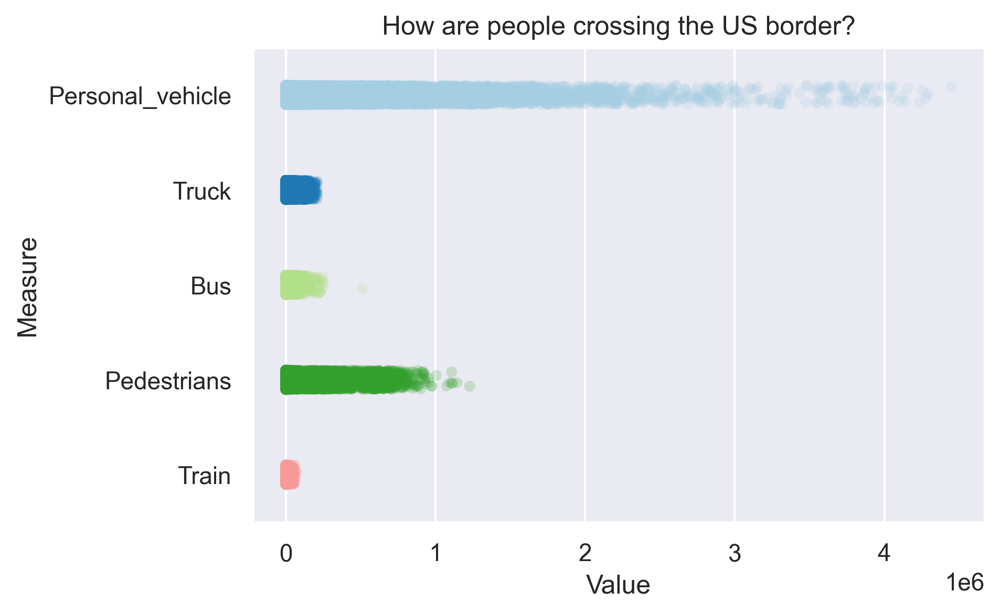

In [39]:
sns.set_style("darkgrid")
sns.set_palette("Paired")

fg, ax = plt.subplots(dpi=300)
sns.stripplot(y='Measure', x='Value', alpha =0.2, data = df_1);
ax.set_title('How are people crossing the US border?')

It would be helpful to observe the data by border level. In other words, are there different patterns between the entry from Canada, and entry from Mexico.

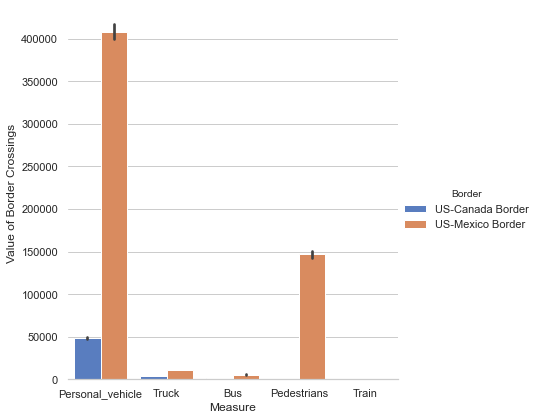

In [40]:
import seaborn as sns
sns.set(style="whitegrid")

# Draw a nested barplot to show survival for class and sex
g = sns.catplot(x="Measure", y="Value", hue="Border", data=df_1,
                height=6, kind="bar", palette="muted")
g.despine(left=True)
g.set_ylabels("Value of Border Crossings")

We can see that personal vehicles are the most used mode at both borders. Interestingly, **entry by foot** is far more common at the US-Mexico Border. Let's take a look at the plot with a logged axis.

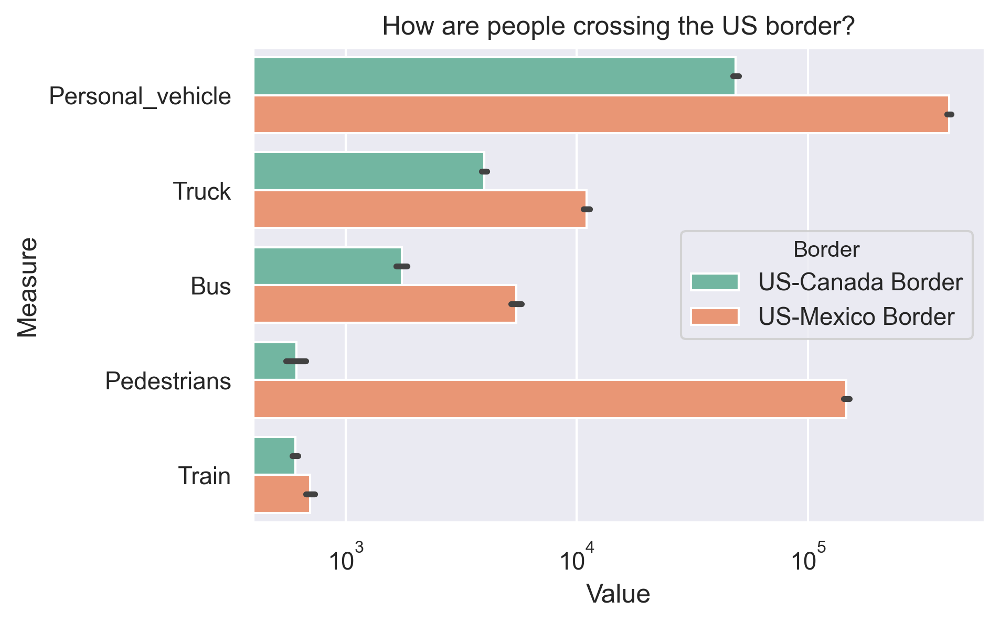

In [42]:
sns.set_style("darkgrid")
sns.set_palette("Set2")

fg, ax = plt.subplots(dpi=300)
sns.barplot(y='Measure', x='Value', hue="Border", data = df_1);
ax.set_title('How are people crossing the US border?')


ax.set_xscale("log")


In [44]:
import plotly.express as px

ax.set_yscale("log")
fig = px.bar(df_1, x="Measure", y="Value")

fig.update_layout(font=dict(family="Arial",size=10),
    plot_bgcolor='rgb(243,243,243)',paper_bgcolor='rgb(243,243,243)',
    title_text='Box plot distribution for method of transport')
fig.show()

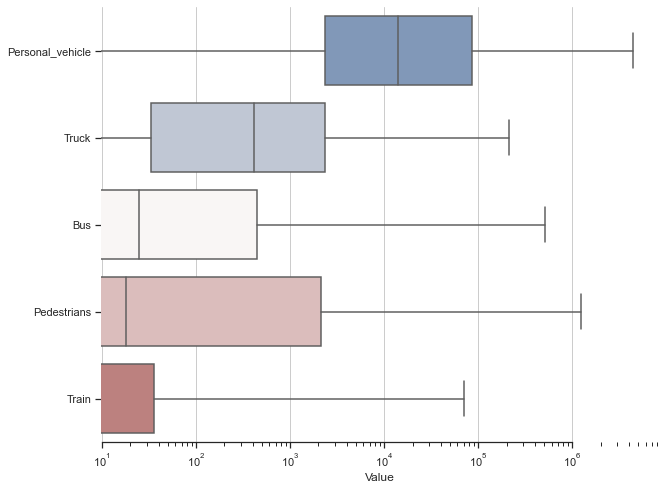

In [45]:
sns.set(style="ticks")

# Initialize the figure with a logarithmic x axis
f, ax = plt.subplots(figsize=(10, 8))
ax.set_xscale("log")

# Plot the orbital period with horizontal boxes
sns.boxplot(x="Value", y="Measure", data=df_1,
            whis=[0, 100], palette="vlag")

# Tweak the visual presentation
ax.xaxis.grid(True)
ax.set(ylabel="")
sns.despine(trim=True, left=True)

In [46]:
# Take the values and set the date as index
m = people[['Date','Measure','Value']].set_index('Date')

# Group by years and border
m = m.groupby([m.index.year,'Measure']).sum()
m.head(10)

Value
Date Measure                               
1996 Bus Passengers                 5813778
     Pedestrians                   34717351
     Personal Vehicle Passengers  272593220
     Train Passengers                224881
1997 Bus Passengers                 6896919
     Pedestrians                   44461186
     Personal Vehicle Passengers  307001980
     Train Passengers                260610
1998 Bus Passengers                 7608484
     Pedestrians                   45060023

In [47]:
# Bar chart 
measures = ['Personal Vehicle Passengers', 'Bus Passengers','Pedestrians', 'Train Passengers']
yrs = m.unstack().index.values

fig = go.Figure(data = [go.Bar(x = yrs, y = m.loc(axis=0)[:, mes].values.flatten().tolist(), name = mes) for mes in measures ])
    
fig.update_layout(title = 'Total inbounds (people), by measure and years', barmode='stack', xaxis={'categoryorder':'category ascending'})
fig.show()

The plot above suggests that the mode of entry into the US has been fairly consistent over the 25 year period.

## EDA - Time Series Analysis
Let's begin to look at the relationship over time. What has changed since 1996? Are there any key trends?

In [48]:
# We are going to create a new dataframe and drop the variables that are not needed for this feature analysis
col = ['Port Name', 'State', 'Port Code', 'Border', 'Measure']
df2 = border_df.drop(col, axis=1)
df2.head()

,Date,Value
0,2020-02-01,1414
1,2020-02-01,763
2,2020-02-01,412
3,2020-02-01,122
4,2020-02-01,545


In [49]:
# Examine the data types
df2.dtypes

Date     datetime64[ns]
Value             int64
dtype: object

In [50]:
# Convert dates from strings to datetime format
df2['Date'] = pd.to_datetime(df2['Date'])

In [51]:
# Set the datetime index
df2 = df2.set_index('Date')

In [52]:
# Check if the index has been set
df2.index

DatetimeIndex(['2020-02-01', '2020-02-01', '2020-02-01', '2020-02-01',
               '2020-02-01', '2020-02-01', '2020-02-01', '2020-02-01',
               '2020-02-01', '2020-02-01',
               ...
               '1996-01-01', '1996-01-01', '1996-01-01', '1996-01-01',
               '1996-01-01', '1996-01-01', '1996-01-01', '1996-01-01',
               '1996-01-01', '1996-01-01'],
              dtype='datetime64[ns]', name='Date', length=355511, freq=None)

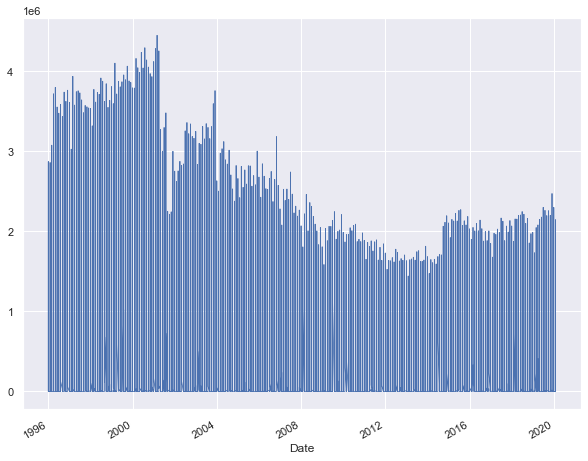

In [53]:
# Time plot of the value of border crossings 

sns.set(rc={'figure.figsize':(10, 8)})

df2['Value'].plot(linewidth=0.8)

[Text(0, 0.5, 'Number of People'),
 Text(0.5, 0, 'Date'),
 Text(0.5, 1.0, 'Number of people crossing the US border')]

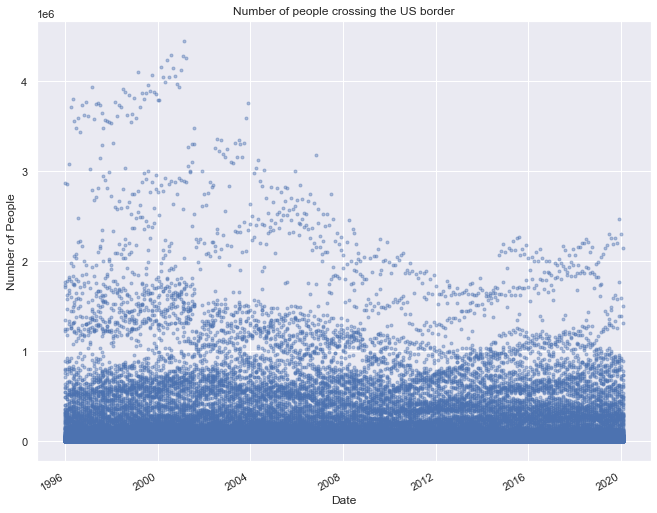

In [54]:
axes = df2['Value'].plot(marker='.', alpha=0.4, linestyle='None', figsize=(11, 9))
axes.set(xlabel="Date",ylabel="Number of People",title="Number of people crossing the US border")


In [55]:
# We are going to create a new dataframe and drop the variables that are not needed for this feature analysis
col = ['Port Name', 'State', 'Port Code','Measure']
df4 = border_df.drop(col, axis=1)
df4.head()

,Border,Date,Value
0,US-Canada Border,2020-02-01,1414
1,US-Canada Border,2020-02-01,763
2,US-Canada Border,2020-02-01,412
3,US-Canada Border,2020-02-01,122
4,US-Canada Border,2020-02-01,545


In [56]:
# Convert dates from strings to datetime format

df4['Date'] = pd.to_datetime(df4['Date'])

In [57]:
# Set the datetime index
df4 = df4.set_index('Date')

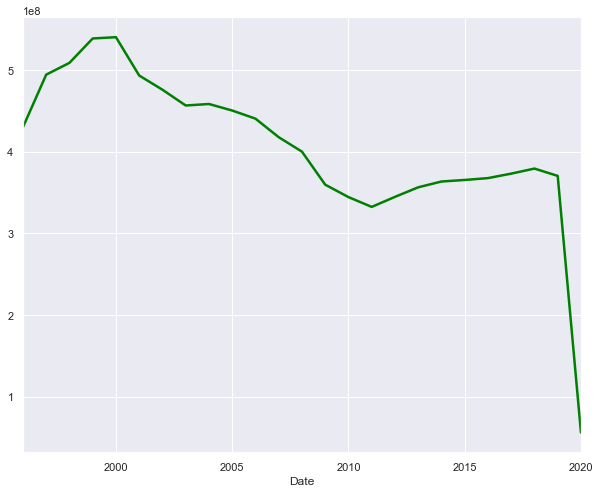

In [58]:
# Plot by the total value of border crossings over the years

year = df4.resample('Y').sum()

year['Value'].plot(linewidth=2.5, color="Green")  

In [59]:
# Take the values and set the date as index
mb = people[['Date','Border','Measure','Value']].set_index('Date')

# Group by years and border
mb = mb.groupby([mb.index.year,'Border','Measure']).sum()


/Users/joseph_arber/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:6: UserWarning:

Matplotlib is currently using module://ipykernel.pylab.backend_inline, which is a non-GUI backend, so cannot show the figure.



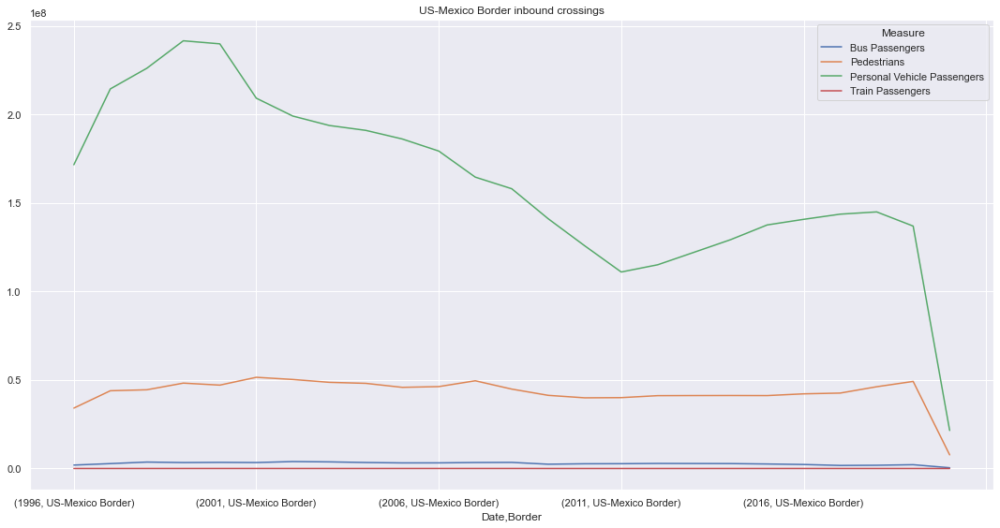

In [60]:
# Plot only the Mexican border (use the loc function to access the Mexico Border values)
sns.set(rc={'figure.figsize':(15, 8)})
fig,ax = plt.subplots()
mb.loc(axis=0)[:,'US-Mexico Border', :].unstack().Value.plot(title='US-Mexico Border inbound crossings',ax=ax)
fig.tight_layout()
fig.show()

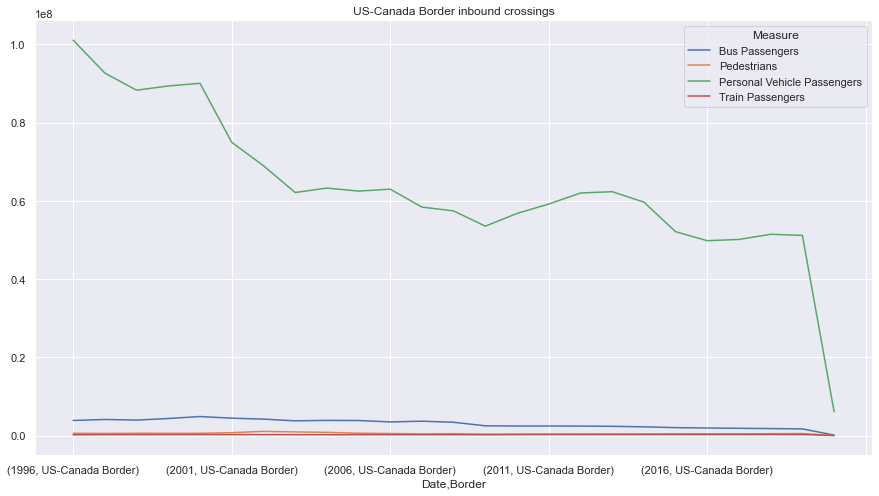

In [61]:
mb.loc(axis=0)[:,'US-Canada Border', :].unstack().Value.plot(title='US-Canada Border inbound crossings')
plt.show()

# Time-Series Forecasting

In [62]:
from sklearn.linear_model import Ridge
from sklearn.model_selection import cross_val_score

from statsmodels.graphics.tsaplots import plot_acf, plot_pacf

In [63]:
df2 = df2.stack()

In [64]:
from statsmodels.tsa.seasonal import seasonal_decompose

In [65]:
# Groupby border to examine the relationship between Canada and Mexico

people_crossing_series = people[['Date','Value']].groupby('Date').sum()

people_crossing_series_CAN = people[people['Border'] == 'US-Canada Border'][['Date','Value']].groupby('Date').sum()

people_crossing_series_MEX = people[people['Border'] == 'US-Mexico Border'][['Date','Value']].groupby('Date').sum()

Ther **rolling average** is a calculation to analyze data points by creating a series of averages of different subsets of the full data set.

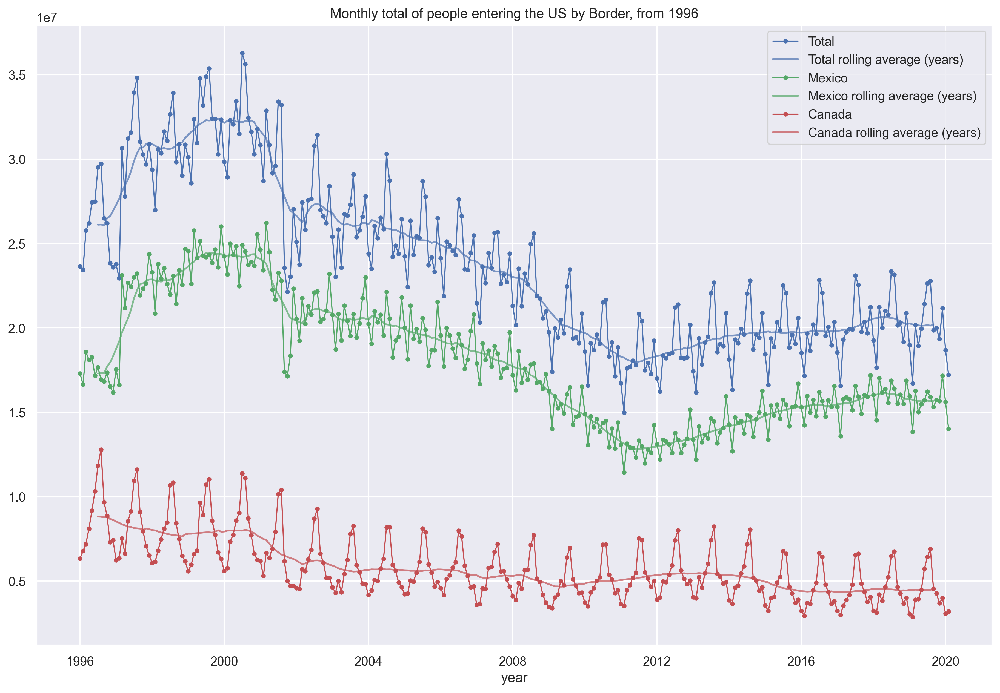

<Figure size 1080x720 with 0 Axes>

In [67]:
sns.set(rc={'figure.figsize':(15, 10)})

fig, ax = plt.subplots(dpi = 300)

# Rolling mean by years
rmean = people_crossing_series.rolling(12, center=True).mean()

rmean_MEX = people_crossing_series_MEX.rolling(12, center=True).mean()

rmean_CAN = people_crossing_series_CAN.rolling(12, center=True).mean()


ax.plot(people_crossing_series, marker='.', linestyle='-', linewidth=1, alpha = 1, label='Total')
ax.plot(rmean,
        marker=None, linestyle='-', linewidth=1.5, alpha = 0.7, label='Total rolling average (years)', color = 'b')

ax.plot(people_crossing_series_MEX, marker='.', linestyle='-', linewidth=1, alpha = 1, label='Mexico', color = 'g')
ax.plot(rmean_MEX,
       marker=None, linestyle='-', linewidth=1.5, alpha = 0.7, label='Mexico rolling average (years)', color = 'g')

ax.plot(people_crossing_series_CAN, marker='.', linestyle='-', linewidth=1, alpha = 1, label='Canada', color = 'r')
ax.plot(rmean_CAN,
       marker=None, linestyle='-', linewidth=1.5, alpha = 0.7, label='Canada rolling average (years)', color = 'r')

ax.set(title = 'Monthly total of people entering the US by Border, from 1996', xlabel = 'year')
ax.legend()

plt.show()
plt.savefig('Average Monthly Total of US Border Crossings, from 1996.png', dpi=300)

We can also take a look at the **expanding mean.** 

In [68]:
#rolling_mean = u['unemployment_rate'].resample('Q').sum().rolling(window=2, center=True).mean()
#exp_weighted_mean = u['unemployment_rate'].resample('Q').sum().ewm(span=10).mean()

NameError: name 'u' is not defined

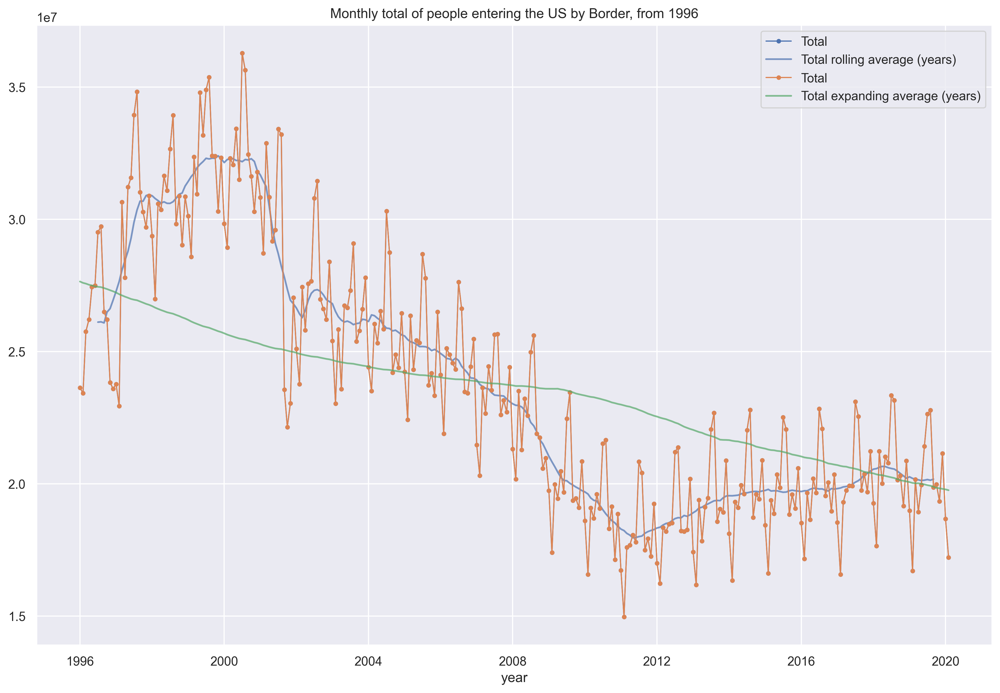

In [69]:
sns.set(rc={'figure.figsize':(15, 10)})

fig, ax = plt.subplots(dpi = 300)

# Rolling mean by years
rmean = people_crossing_series.rolling(12, center=True).mean()
emean = people_crossing_series.expanding(12, center=True).mean()


ax.plot(people_crossing_series, marker='.', linestyle='-', linewidth=1, alpha = 1, label='Total')
ax.plot(rmean,
        marker=None, linestyle='-', linewidth=1.5, alpha = 0.7, label='Total rolling average (years)', color = 'b')


ax.plot(people_crossing_series, marker='.', linestyle='-', linewidth=1, alpha = 1, label='Total')
ax.plot(emean,
        marker=None, linestyle='-', linewidth=1.5, alpha = 0.7, label='Total expanding average (years)', color = 'g')



ax.set(title = 'Monthly total of people entering the US by Border, from 1996', xlabel = 'year')
ax.legend()

plt.show()

Why was there a drop in **2002**, that lasted until **2012**? Is there are granular relationship here? Let's drill down to a smaller time frame.

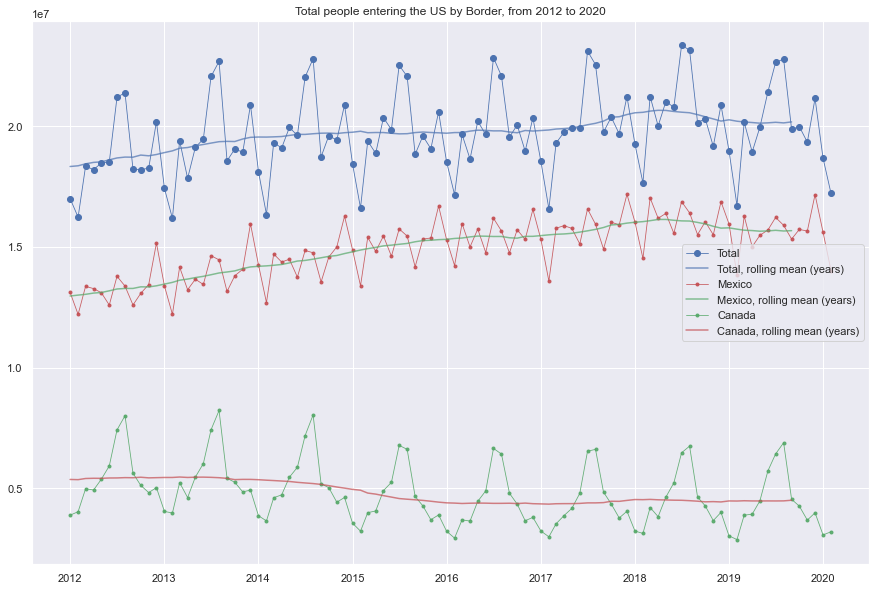

In [70]:
fig, ax = plt.subplots()



start = '2012'
end = '2020'


ax.plot(people_crossing_series.loc[start:end],
       marker='o', linestyle='-', linewidth=0.8, alpha = 1, label='Total', color = 'b')
ax.plot(rmean.loc[start:end],
       marker=None, linestyle='-', linewidth=1.5, alpha = 0.7, label='Total, rolling mean (years)', color = 'b')

ax.plot(people_crossing_series_MEX.loc[start:end],
       marker='.', linestyle='-', linewidth=0.8, alpha = 0.9, label='Mexico', color = 'r')
ax.plot(rmean_MEX.loc[start:end],
       marker=None, linestyle='-', linewidth=1.5, alpha = 0.7, label='Mexico, rolling mean (years)', color = 'g')

ax.plot(people_crossing_series_CAN.loc[start:end],
       marker='.', linestyle='-', linewidth=0.8, alpha = 0.9, label='Canada',color = 'g')
ax.plot(rmean_CAN.loc[start:end],
       marker=None, linestyle='-', linewidth=1.5, alpha = 0.7, label='Canada, rolling mean (years)', color = 'r')

ax.set(title = 'Total people entering the US by Border, from {} to {}'.format(start, end))
ax.legend()

plt.show()

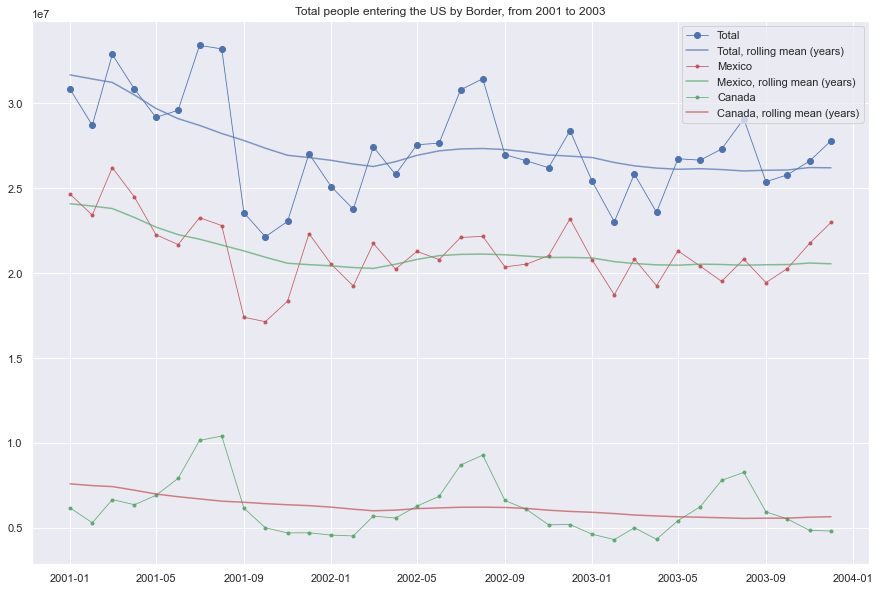

In [71]:
fig, ax = plt.subplots()



start = '2001'
end = '2003'


ax.plot(people_crossing_series.loc[start:end],
       marker='o', linestyle='-', linewidth=0.8, alpha = 1, label='Total', color = 'b')
ax.plot(rmean.loc[start:end],
       marker=None, linestyle='-', linewidth=1.5, alpha = 0.7, label='Total, rolling mean (years)', color = 'b')

ax.plot(people_crossing_series_MEX.loc[start:end],
       marker='.', linestyle='-', linewidth=0.8, alpha = 0.9, label='Mexico', color = 'r')
ax.plot(rmean_MEX.loc[start:end],
       marker=None, linestyle='-', linewidth=1.5, alpha = 0.7, label='Mexico, rolling mean (years)', color = 'g')

ax.plot(people_crossing_series_CAN.loc[start:end],
       marker='.', linestyle='-', linewidth=0.8, alpha = 0.9, label='Canada',color = 'g')
ax.plot(rmean_CAN.loc[start:end],
       marker=None, linestyle='-', linewidth=1.5, alpha = 0.7, label='Canada, rolling mean (years)', color = 'r')

ax.set(title = 'Total people entering the US by Border, from {} to {}'.format(start, end))
ax.legend()

plt.show()

The analysis above suggests that the total average of border crossings, is mostly a reflection of the average number of border crossings from Mexico. In contrast, Canada's pattern is fairly consistent, and in 2003, when Mexico's count falls, Canada's count rises.

In [73]:
import numpy as np

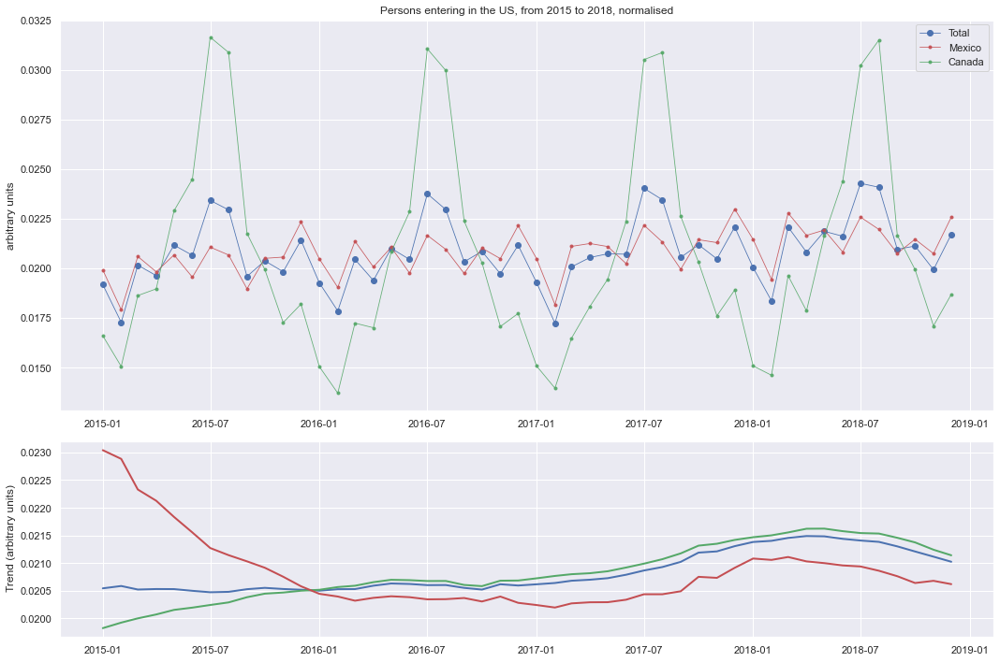

In [79]:
import matplotlib.gridspec as mgrid

fig = plt.figure()


grid = mgrid.GridSpec(nrows=2, ncols=1, height_ratios=[2, 1])

seas = fig.add_subplot(grid[0])
trend = fig.add_subplot(grid[1], sharex = seas)

start = '2015'
end = '2018'

seas.plot(people_crossing_series.loc[start:end]/people_crossing_series.loc[start:end].sum(),
       marker='o', linestyle='-', linewidth=0.8, alpha = 1, label='Total', color = 'b')

seas.plot(people_crossing_series_MEX.loc[start:end]/people_crossing_series_MEX.loc[start:end].sum(),
       marker='.', linestyle='-', linewidth=0.8, alpha = 0.9, label='Mexico', color = 'r')

seas.plot(people_crossing_series_CAN.loc[start:end]/people_crossing_series_CAN.loc[start:end].sum(),
       marker='.', linestyle='-', linewidth=0.8, alpha = 0.9, label='Canada', color = 'g')

seas.set(title = 'Persons entering in the US, from {} to {}, normalised'.format(start, end),
      ylabel = 'arbitrary units')
seas.legend()

trend.plot(rmean.loc[start:end]/rmean.loc[start:end].sum(),
       marker='', linestyle='-', linewidth=2, alpha = 1, label='Total', color = 'b')

trend.plot(rmean_MEX.loc[start:end]/rmean_MEX.loc[start:end].sum(),
       marker='', linestyle='-', linewidth=2, alpha = 1, label='Mexico', color = 'g')

trend.plot(rmean_CAN.loc[start:end]/rmean_CAN.loc[start:end].sum(),
       marker='', linestyle='-', linewidth=2, alpha = 1, label='Canada', color = 'r')

trend.set(ylabel = ' Trend (arbitrary units)')
fig.tight_layout()
plt.show()